# Exploring the Contributing Factors on the International Outlook on Universities

In [1]:
options(warn=-1)

library(tidyverse) 

library(broom)
library(latex2exp)
library(tidymodels)
library(repr)
library(gridExtra) 
library(faraway)
library(mltools) 
library(leaps)
library(glmnet)
library(cowplot)
library(modelr)
library(caret) 
library(pROC)
library(boot)
library(GGally)

options(warn=0)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.4.4     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ dials        1.2.0     ✔ rsample      1.2.0
✔ infer        1.0.5     ✔ tune         1.1.2
✔ modeldata    1.2.0     ✔ workflows    1.1.3
✔ parsnip      1.1.1     ✔ workflowsets 1.0.1
✔ recipes      1.0.8     ✔ yardstick    1.2.0

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filter()   masks stats::filter

### 1. Introduction

In recent years, global academic institutions have experienced a significant increase in international enrollment. According to CBIE and Applyboard, in 2023 Canada alone saw a 23% rise in international students compared to the previous year, making it the third most popular destination for foreign scholars (CBIE, 2024;; Basiri, 2024). In response to this growing demand, universities and colleges are actively studying the factors that influence international students' choices. The insights from these studies can help institutions develop programs and facilities that effectively cater to the increasing demand for international education.  
  
Identifying the factors that significantly impact an international student’s decision is complex. Paulino and Castano from the University of Santo Tomas reported mixed results when analyzing global literature databases on this topic, highlighting the need for further research into the decision-making processes of international students (Paulino & Castano, 2020). Conversely, Katsumoto et al. from the University of Iowa found a significant correlation between the national ranking of U.S. universities and colleges and international student enrollment, a correlation not observed among domestic students (Katsumoto, Bowman, & Tennessen, 2024). 
  
Building on this background, our study aims to answer two main questions:  

   **1. What are the factors that make a university appealing to international students?**  
   **2. Can we predict the outlook on a university from the identified factors?**  

We will use the World University Ranking 2023 dataset from Kaggle, which includes data on over 1,000 universities worldwide. Each university is assessed using 13 variables, five of which are numerical scores out of 100, quantifying performance in Teaching, Research, Citations, Industry, and International Outlook. These five scores contribute to the calculation of the Overall Score, which determines the rankings. The dataset also includes other quantitative data, such as the proportion of international students, the female-to-male ratio, and the average number of students per professor/instructor. Our reponse variable is the International Outlook Score, as it indicates a university's attractiveness to international students. We employed multiple linear regression and variable selection algorithms to develop models for our analysis.

### 2. Methods

#### 2.1 Data Loading  

Let's begin our EDA by reading in the data from our data file "WUR2023". We assign the data to the `WUR_2023` variable using the `read.csv()` function and the path to the dataset. 

In [2]:
# Main developer: Tommy 


WUR_2023 <- read.csv("data/WUR2023.csv", na.strings = c('', "NA"))

head(WUR_2023)

,University.Rank,Name.of.University,Location,No.of.student,No.of.student.per.staff,International.Student,Female.Male.Ratio,OverAll.Score,Teaching.Score,Research.Score,Citations.Score,Industry.Income.Score,International.Outlook.Score
,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,1,University of Oxford,United Kingdom,"20,965",10.6,42%,48 : 52,96.4,92.3,99.7,99.0,74.9,96.2
2,2,Harvard University,United States,"21,887",9.6,25%,50 : 50,95.2,94.8,99.0,99.3,49.5,80.5
3,3,University of Cambridge,United Kingdom,"20,185",11.3,39%,47 : 53,94.8,90.9,99.5,97.0,54.2,95.8
4,3,Stanford University,United States,"16,164",7.1,24%,46 : 54,94.8,94.2,96.7,99.8,65.0,79.8
5,5,Massachusetts Institute of Technology,United States,"11,415",8.2,33%,40 : 60,94.2,90.7,93.6,99.8,90.9,89.3
6,6,California Institute of Technology,United States,"2,237",6.2,34%,37 : 63,94.1,90.9,97.0,97.3,89.8,83.6


#### 2.2 Data Cleaning

The variable names in the loaded dataframe are not well-suited for our needs, making it difficult to work with the data effectively. To improve usability, we’ve decided to rename these variables to more appropriate names in accordance with Tidyverse's Style Guide. For this task, we will use the `rename()` function from the `dplyr` package.

In [3]:
# Main developer: Tommy 
# Contributor: Stallon

# Rename variables for better clarity

WUR_2023 <- 
    WUR_2023 %>%
        rename(
            uni_rank = University.Rank,
            uni_name = Name.of.University,
            uni_loc = Location,
            num_of_student = No.of.student,
            student_per_staff = No.of.student.per.staff,
            int_student_prop = International.Student,
            female_male_ratio = Female.Male.Ratio,
            overall_score = OverAll.Score,
            teaching_score = Teaching.Score,
            research_score = Research.Score,
            citation_score = Citations.Score,
            industry_score = Industry.Income.Score,
            international_score = International.Outlook.Score
            )

head(WUR_2023)

,uni_rank,uni_name,uni_loc,num_of_student,student_per_staff,int_student_prop,female_male_ratio,overall_score,teaching_score,research_score,citation_score,industry_score,international_score
,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,1,University of Oxford,United Kingdom,"20,965",10.6,42%,48 : 52,96.4,92.3,99.7,99.0,74.9,96.2
2,2,Harvard University,United States,"21,887",9.6,25%,50 : 50,95.2,94.8,99.0,99.3,49.5,80.5
3,3,University of Cambridge,United Kingdom,"20,185",11.3,39%,47 : 53,94.8,90.9,99.5,97.0,54.2,95.8
4,3,Stanford University,United States,"16,164",7.1,24%,46 : 54,94.8,94.2,96.7,99.8,65.0,79.8
5,5,Massachusetts Institute of Technology,United States,"11,415",8.2,33%,40 : 60,94.2,90.7,93.6,99.8,90.9,89.3
6,6,California Institute of Technology,United States,"2,237",6.2,34%,37 : 63,94.1,90.9,97.0,97.3,89.8,83.6


After renaming the columns, we can more easily access the data. However, since the dataset contains a mix of names, numbers, ratios, and percentages, we need to transform these values into a consistent numeric format to facilitate further analysis and modeling. To achieve this, we will use the `mutate()` function from the `dplyr package.

Key Steps:

•	**Convert numbers to a numeric format**: All numerical data will be standardized to ensure consistent handling across our analysis. `num_of_student`, `overall_score`, `teaching_score`, `research_score`, `citation_score`, `industry_score`, `international_score` are all of type `char` and need to be changed into a standard numerical data type like `dbl`.  
•	**Transform ratios**: `female_male_ratio` will be split into `male_ratio` and `female_ratio` and converted into `dbl`, making them easier to interpret and use in models.  
•	**Convert percentages to decimals**: Percentage values such as `int_student_prop` will be transformed into their decimal equivalents for consistency and compatibility with numerical operations.  

In [4]:
# Main developer: Tommy 
# Contributor: Stallon

# Convert character values to numeric values, and replace all n/a, missing values and NaN with NA.

options(warn=-1)

WUR_2023 <- 
    WUR_2023 %>%
        mutate(
            uni_rank = na_if(uni_rank, "-"),
            uni_name = na_if(uni_name, "NaN"),
            int_student_prop = as.numeric(gsub("[\\%]", "", int_student_prop)) / 100,
            num_of_student = as.numeric(gsub("[\\,]", "", num_of_student))                
        ) %>% 
        separate_wider_delim(
            female_male_ratio,
            ":",
            names = c("female_prop", "male_prop"),
            too_few = "align_start"
        ) %>%
        mutate(
            female_prop = as.numeric(female_prop) / 100,
            male_prop = as.numeric(male_prop) / 100,
            overall_score = na_if(overall_score, "n/a"),
            overall_score = sapply(
                strsplit(overall_score, split = "-", fixed = TRUE),
                function(k) mean(as.numeric(k), na.rm = TRUE)
            ),
            teaching_score = na_if(teaching_score, "n/a"),
            teaching_score = as.numeric (teaching_score, na.rm = TRUE),
            research_score = na_if(research_score, "n/a"),
            research_score = as.numeric(research_score),
            citation_score = na_if(citation_score, "n/a"),
            citation_score = as.numeric(citation_score),
            industry_score = na_if(industry_score, "n/a"),
            industry_score = as.numeric(industry_score),
            international_score = na_if(international_score, "n/a"),
            international_score = as.numeric(international_score)
        ) 

            
options(warn=0)

# Uncomment this line to view the cleaned data
# write.csv(WUR_2023, "data/WUR2023_test.csv", row.names = TRUE)

# Uncomment this line to remove all NaN values
# WUR_2023 %>% drop.na()


head(WUR_2023)

uni_rank,uni_name,uni_loc,num_of_student,student_per_staff,int_student_prop,female_prop,male_prop,overall_score,teaching_score,research_score,citation_score,industry_score,international_score
<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,University of Oxford,United Kingdom,20965,10.6,0.42,0.48,0.52,96.4,92.3,99.7,99.0,74.9,96.2
2,Harvard University,United States,21887,9.6,0.25,0.50,0.50,95.2,94.8,99.0,99.3,49.5,80.5
3,University of Cambridge,United Kingdom,20185,11.3,0.39,0.47,0.53,94.8,90.9,99.5,97.0,54.2,95.8
3,Stanford University,United States,16164,7.1,0.24,0.46,0.54,94.8,94.2,96.7,99.8,65.0,79.8
5,Massachusetts Institute of Technology,United States,11415,8.2,0.33,0.40,0.60,94.2,90.7,93.6,99.8,90.9,89.3
6,California Institute of Technology,United States,2237,6.2,0.34,0.37,0.63,94.1,90.9,97.0,97.3,89.8,83.6


#### 2.3 Exploratory Data Analysis (EDA)

With the data now cleaned and in a usable format, we can proceed to conduct some EDA and explore the relationships between variables. For this purpose, the `ggpairs()` function, along with `ggplot2` from the `GGally` library, provides powerful tools to create comprehensive visualizations.

***2.3.1 Correlation Analysis***

To begin our EDA, we decided to first examine the correlation between variables. Understanding these correlations will help us determine the most suitable plots for visualizing the data effectively. We used the `ggpairs()` function to visualize pairwise relationships and correlations between variables.

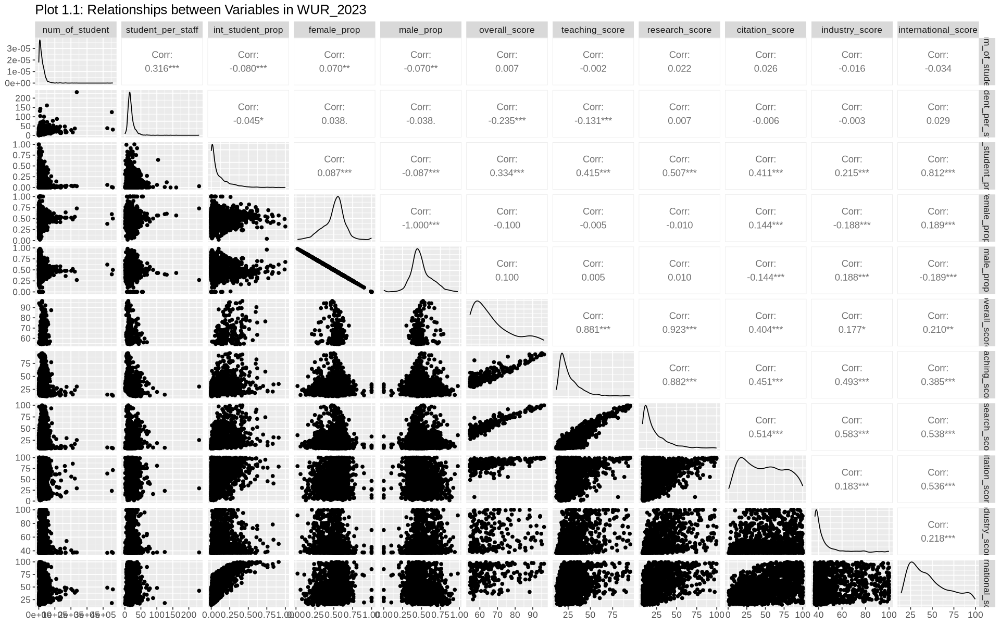

In [5]:
# Main developer: Paul

options(warn=-1)

options(repr.plot.width = 16, repr.plot.height = 10)

pairs <- 
    WUR_2023 %>%
        select(-uni_rank, -uni_name, -uni_loc) %>%
        ggpairs(progress = FALSE) +
        theme(text = element_text(size = 13)) +
        ggtitle("Plot 1.1: Relationships between Variables in WUR_2023") 

pairs

options(warn=0)

From Plot 1.1, we observe that `international_score`, our variable of interest, is strongly correlated with `int_student_prop` (0.812). Additionally, it shows moderate correlations with all scores other than `overall_score` (0.210) and `industry_score` (0.218), which are only slightly correlated. `female_prop` (0.189) and `male_prop` (-0.189) are lightly correlated with the international outlook score, but since they are inversely related, we will focus on the female proportion for the remainder of our analysis. `num_of_student` (-0.034) and `student_per_staff` (0.029) show no noteable correlation with the response variable. 

***2.3.2 ggplot2***

To further explore these relationships, we will use `ggplot2` to model the international outlook score on the y-axis against all the relevant variables. This approach will help us visualize potential trends in the data before making any assumptions about the variables that will be included in our final regression model.

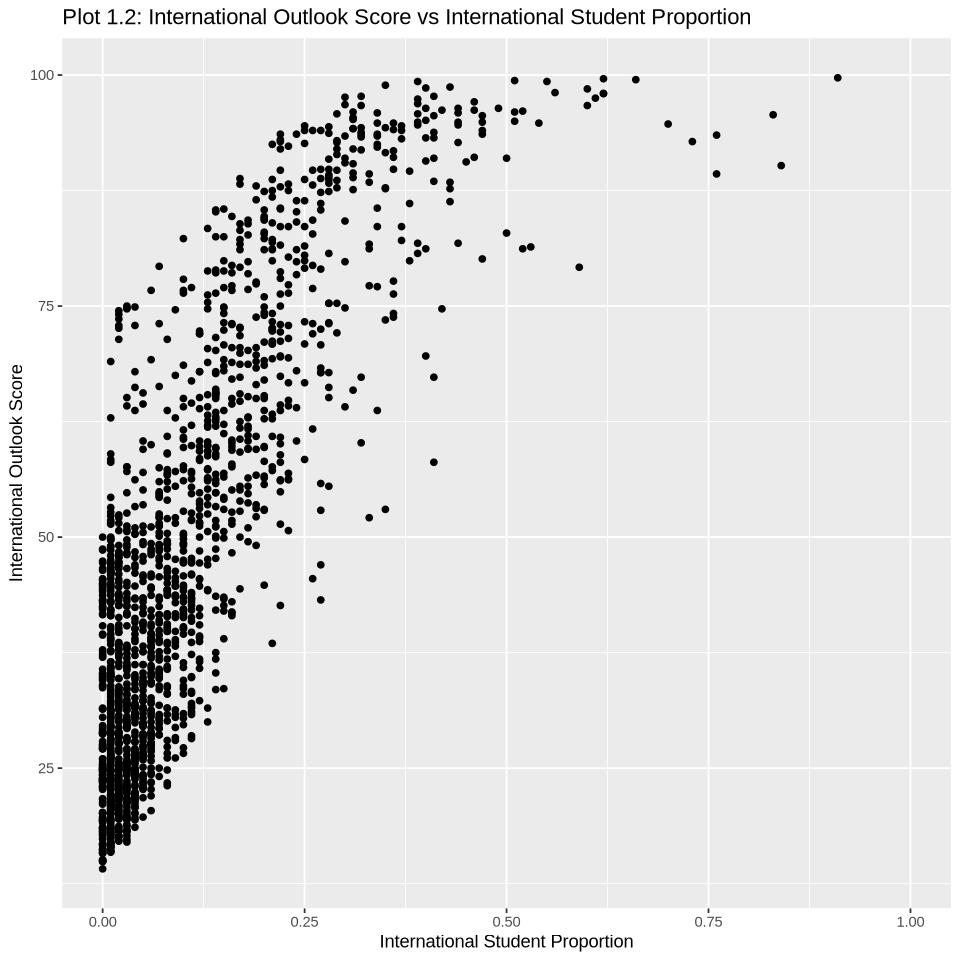

In [6]:
# Main developer: Paul

options(warn=-1)

options(repr.plot.width = 8, repr.plot.height = 8)

gplot1 <- 
    ggplot(data = WUR_2023, aes(y = international_score, x = int_student_prop)) +
    geom_point() + 
    xlab("International Student Proportion") +
    ylab("International Outlook Score") +
    ggtitle("Plot 1.2: International Outlook Score vs International Student Proportion")

gplot1

options(warn=0)

Plot 1.2 reveals a very strong positive correlation between the international student proportion and the international outlook score. As the proportion of international students increases, we observe a corresponding rise in the international outlook score. This suggests that the international student proportion is likely a significant predictor of a university’s outlook score.

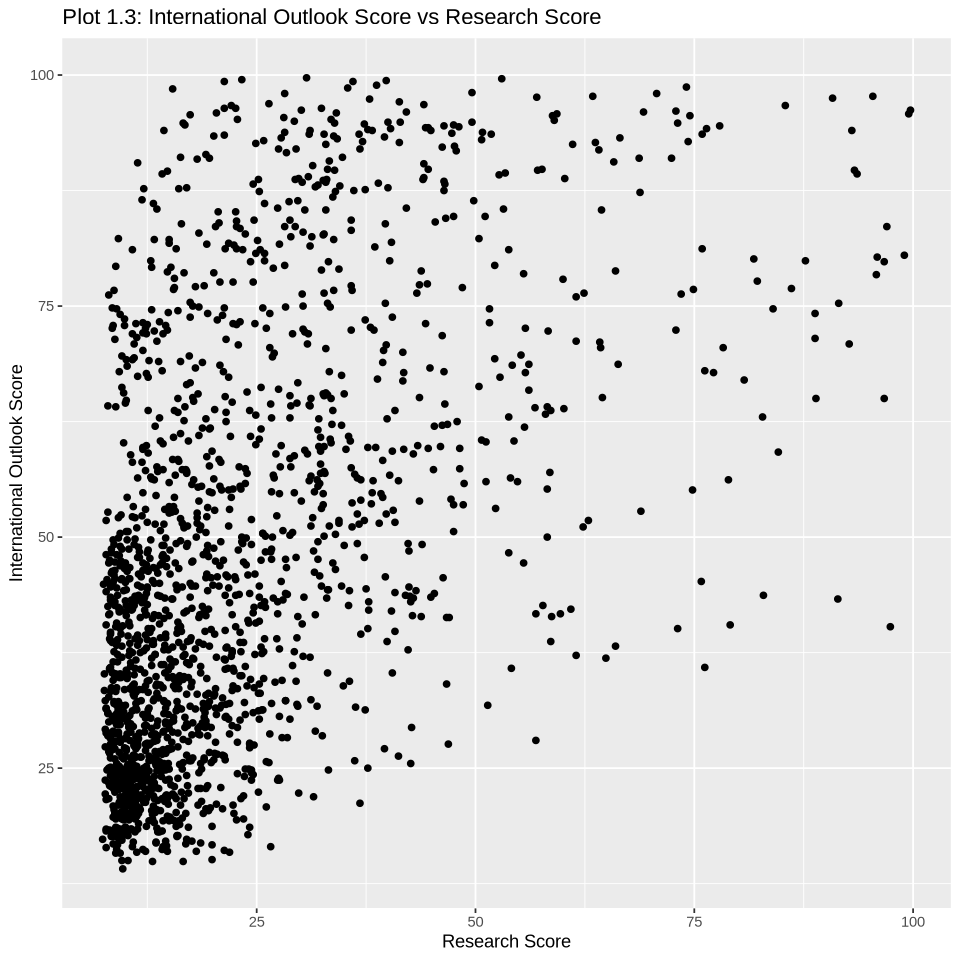

In [7]:
# Main developer: Paul

options(warn=-1)

options(repr.plot.width = 8, repr.plot.height = 8)

gplot2 <-
    ggplot(data = WUR_2023, aes(y = international_score, x = research_score)) +
    geom_point() +
    xlab("Research Score") +
    ylab("International Outlook Score") +
    ggtitle("Plot 1.3: International Outlook Score vs Research Score")

gplot2

options(warn=0)

Compared to Plot 1.2, Plot 1.3 lacks a clear linear trend. Although there is a positive relationship, the data points are more spread out, suggesting less consistency. This dispersion makes it difficult to confidently assert the variable’s significance in the final model. The moderate correlation observed in the ggpairs plot further reinforces this uncertainty.

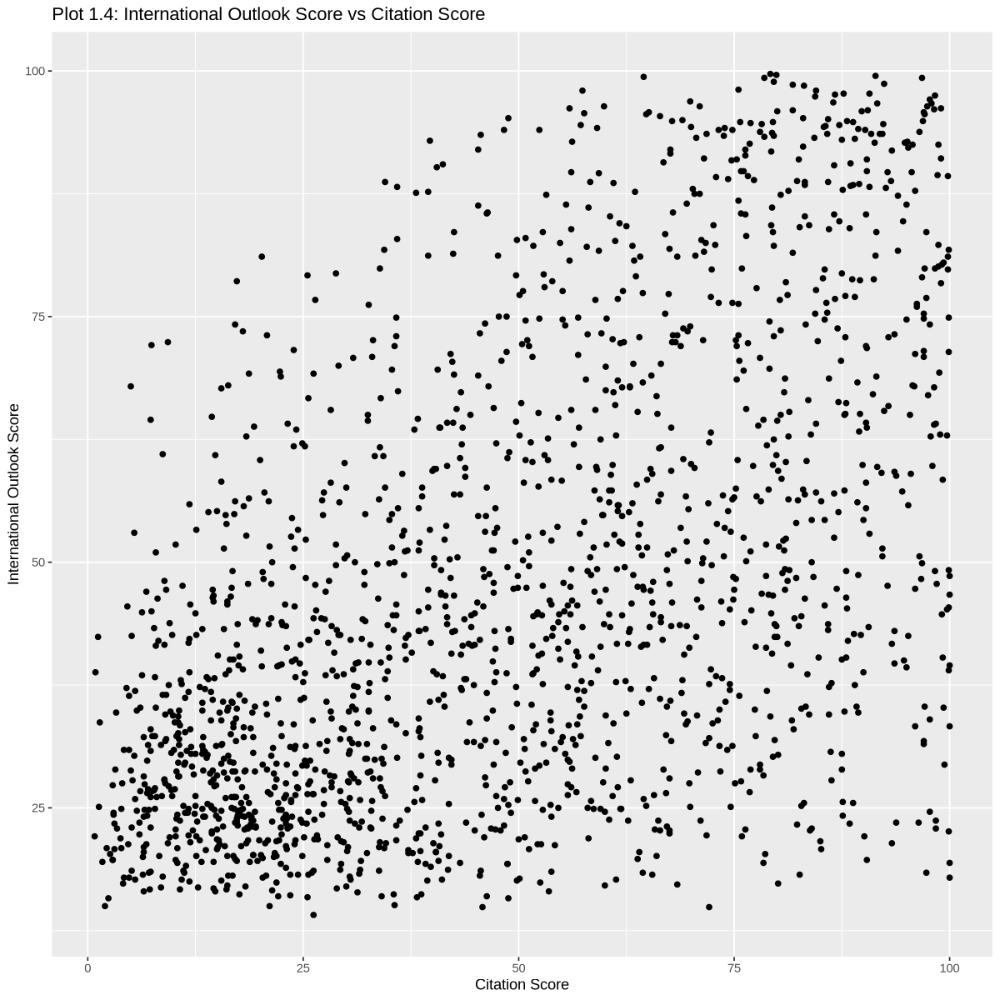

In [8]:
# Main developer: Paul

options(warn=-1)

options(repr.plot.width = 10, repr.plot.height = 10)

gplot3 <-
    ggplot(data = WUR_2023, aes(y = international_score, x = citation_score)) +
    geom_point() +
    xlab("Citation Score") +
    ylab("International Outlook Score") +
    ggtitle("Plot 1.4: International Outlook Score vs Citation Score")

gplot3

options(warn=0)

Similar to Plot 1.3, Plot 1.4 shows a lack of clear linearity in the relationship between the international outlook score and the citation score. This unclear trend suggests that the citation score may not significantly contribute to our final model. Given that lower correlating relationships tend to lack clarity, further graphing of these variables is unnecessary.

Based on our EDA, we anticipate that the final model will likely focus on the international student proportion, along with the research and citation scores. This model can be represented as:

$ \text{international_score} = \beta_0 + \beta_1 \times \text{int_student_prop} + \beta_2 \times \text{research_score} + \beta_3 \times \text{citation_score} + \epsilon $

#### 2.4 Splitting and Standardizing Data

To determine the best model, we will need to train & test multiple models. We are choosing to use more than one approach so that we can compare models and identify the most suitable one for our data. Our models will be generated using Backward Selection and Lasso Regression. We expect that several correlated variables will contribute to the final model so Backward Selection will help eliminate variables that are unnecessary, while Lasso Regression will penalize overfitting and remove covariates that do not contribute significantly to the regression.

We will begin by splitting our data into training and testing sets. This involves standardizing the data using the formula `(x - mean) / sd` applied through `mutate()` across the numeric variables. Then, we will use the `initial_split()` function from the `tidymodels` library with a 0.7 proportion to divide the data. Finally, we will use `training()` and `testing()` to assign the split data into their respective sets.

In [9]:
# Main developer: Paul
# Contributor: Griffin, Stallon

set.seed(1234)

WUR_2023_split <- 
    WUR_2023 %>%
    drop_na() %>%
    mutate(research_score = (research_score - mean(research_score)) / sd(research_score),
        citation_score = (citation_score - mean(citation_score)) / sd(citation_score),
        teaching_score = (teaching_score - mean(teaching_score)) / sd(teaching_score),
        international_score = (international_score - mean(international_score)) / sd(international_score),
        industry_score = (industry_score - mean(industry_score)) / sd(industry_score),
        female_prop = (female_prop - mean(female_prop)) / sd(female_prop),
        student_per_staff = (student_per_staff - mean(student_per_staff)) / sd(student_per_staff),
        male_prop = (male_prop - mean(male_prop)) / sd(male_prop),
        num_of_student = (num_of_student - mean(num_of_student)) / sd(num_of_student),
        int_student_prop = (int_student_prop - mean(int_student_prop)) / sd(int_student_prop)
    ) %>%
    initial_split(prop = 0.7, strata = overall_score)

training_WUR_2023 <- training(WUR_2023_split)
testing_WUR_2023 <- testing(WUR_2023_split)

head(training_WUR_2023)
head(testing_WUR_2023)

uni_rank,uni_name,uni_loc,num_of_student,student_per_staff,int_student_prop,female_prop,male_prop,overall_score,teaching_score,research_score,citation_score,industry_score,international_score
<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
148,University of Colorado Boulder,United States,0.5452304,-0.07938978,-1.2794609,-0.7184570,0.7184570,57.8,-0.574156163,-0.74269934,-0.04470016,-0.9003016,-1.626065148
148,Uppsala University,Sweden,-0.0886468,-0.14139066,-0.5952931,1.1648453,-1.1648453,57.8,-1.064025913,-0.23558678,-0.96823968,0.5094157,-0.060417293
151,University of Florida,United States,1.3479837,-0.07053251,-1.2794609,0.5001504,-0.5001504,57.7,0.001440793,-0.07374235,-1.95454403,-0.5439419,-1.869610370
151,Penn State (Main campus),United States,1.3517681,-0.25653516,-0.6713117,-0.4968921,0.4968921,57.7,-0.439441981,-0.33808826,-0.96823968,-1.0575192,-1.469500363
151,Tufts University,United States,-1.0448012,-0.61082590,-0.6713117,0.5001504,-0.5001504,57.7,-0.482305585,-1.26060152,0.55604885,-0.9631887,-1.289740794
154,University of Rochester,United States,-1.1147439,-0.81454308,0.8490612,-0.1645446,0.1645446,57.6,-0.794597550,-1.05559857,0.08979589,-0.6539942,0.009167056


uni_rank,uni_name,uni_loc,num_of_student,student_per_staff,int_student_prop,female_prop,male_prop,overall_score,teaching_score,research_score,citation_score,industry_score,international_score
<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2,Harvard University,United States,-0.3360481,-0.6462550,0.01285609,-0.1645446,0.1645446,95.2,2.438543,2.100368,1.1926635,-0.6435130,0.39767967
10,Imperial College London,United Kingdom,-0.5618922,-0.5045387,2.74952744,-1.2723695,1.2723695,90.4,1.703738,1.657993,1.1029994,-0.1037328,1.38345795
11,ETH Zurich,Switzerland,-0.3510503,-0.1856770,1.22915447,-2.0478469,2.0478469,89.4,1.691491,1.906155,0.4215528,-0.1404168,1.39505534
14,University of Pennsylvania,United States,-0.3653768,-0.9385448,-0.13918120,0.1678029,-0.1678029,88.8,1.899686,1.550097,0.9864362,0.7347608,-0.12420295
15,Johns Hopkins University,United States,-0.6268342,-1.0802611,0.31693069,0.1678029,-0.1678029,88.3,1.495544,1.695757,0.9864362,1.4527209,0.09614749
18,University of Toronto,Canada,3.4199782,0.7886225,0.08887474,0.5001504,-0.5001504,87.4,1.366953,1.792863,0.6098473,0.1949806,0.93115968


The data has now been successfully split and retains its clean format, allowing us to proceed with forming the regression model.

#### 2.5 Backward Selection

To begin, we will apply backward selection to identify our first model. This will be achieved using the `regsubsets()` function from the `leaps` library. We start by selecting the relevant columns for our model, excluding non-predictive variables such as university rank, location, and name.

In [10]:
# Main developer: Paul
# Contributor: Griffin

# We use the backward selection algorithm to find the best variables using the parisomony's principle and adjusted R^2.

rankings_2023 <- 
    training_WUR_2023 %>%
    select(overall_score, num_of_student:male_prop, teaching_score:international_score)

head(rankings_2023)

overall_score,num_of_student,student_per_staff,int_student_prop,female_prop,male_prop,teaching_score,research_score,citation_score,industry_score,international_score
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
57.8,0.5452304,-0.07938978,-1.2794609,-0.7184570,0.7184570,-0.574156163,-0.74269934,-0.04470016,-0.9003016,-1.626065148
57.8,-0.0886468,-0.14139066,-0.5952931,1.1648453,-1.1648453,-1.064025913,-0.23558678,-0.96823968,0.5094157,-0.060417293
57.7,1.3479837,-0.07053251,-1.2794609,0.5001504,-0.5001504,0.001440793,-0.07374235,-1.95454403,-0.5439419,-1.869610370
57.7,1.3517681,-0.25653516,-0.6713117,-0.4968921,0.4968921,-0.439441981,-0.33808826,-0.96823968,-1.0575192,-1.469500363
57.7,-1.0448012,-0.61082590,-0.6713117,0.5001504,-0.5001504,-0.482305585,-1.26060152,0.55604885,-0.9631887,-1.289740794
57.6,-1.1147439,-0.81454308,0.8490612,-0.1645446,0.1645446,-0.794597550,-1.05559857,0.08979589,-0.6539942,0.009167056


We then use `regsubsets()` to do the backwards selection and output the summary.

In [11]:
# Main developer: Paul
# Contributor: Griffin

options(warn=-1)

rankings_2023_backward_sel <- 
    regsubsets(
        x = international_score ~ ., 
        nvmax = 10,
        data = rankings_2023,
        method = "backward",
    )

summary_rankings <- summary(rankings_2023_backward_sel)

summary_rankings

options(warn=0)

Reordering variables and trying again:


Subset selection object
Call: regsubsets.formula(x = international_score ~ ., nvmax = 10, data = rankings_2023, 
    method = "backward", )
10 Variables  (and intercept)
                  Forced in Forced out
overall_score         FALSE      FALSE
num_of_student        FALSE      FALSE
student_per_staff     FALSE      FALSE
int_student_prop      FALSE      FALSE
female_prop           FALSE      FALSE
teaching_score        FALSE      FALSE
research_score        FALSE      FALSE
citation_score        FALSE      FALSE
industry_score        FALSE      FALSE
male_prop             FALSE      FALSE
1 subsets of each size up to 9
Selection Algorithm: backward
         overall_score num_of_student student_per_staff int_student_prop
1  ( 1 ) "*"           " "            " "               " "             
2  ( 1 ) "*"           " "            " "               " "             
3  ( 1 ) "*"           " "            " "               " "             
4  ( 1 ) "*"           " "            " "       

Following this, we output the Adjusted R-squared values, RSS and RSQ to determine that covariates we want to include.

In [12]:
# Main developer: Paul

rankings_2023_summary_df <- 
    tibble(
        n_input_variables = 1:9,
        RSQ = summary_rankings$rsq,
        RSS = summary_rankings$rss,
        ADJ.R2 = summary_rankings$adjr2
    )

rankings_2023_summary_df


n_input_variables,RSQ,RSS,ADJ.R2
<int>,<dbl>,<dbl>,<dbl>
1,0.06363858,80.60876072,0.05323457
2,0.40007461,51.64591494,0.38659314
3,0.49950438,43.08628152,0.48244203
4,0.89591710,8.96020884,0.89113168
5,0.99938042,0.05333799,0.99934440
6,0.99941346,0.05049380,0.99937205
7,0.99942678,0.04934706,0.99937901
8,0.99942685,0.04934111,0.99937160
9,0.99942690,0.04933653,0.99936400


We will use the highest adj.R2 to select our variables for goodness of fit. In this case, it will be 7 variables, in this order:

**• research_score**  
**• citation score**  
**• teaching score**  
**• overall_score**  
**• industry_score**  
**• female_prop**  
**• student_per_staff**   

Following this selection, we can now create out regression model. 

#### 2.6 - Generative Model and R2


In [13]:
# Main developer: Paul
# Contributor: Griffin

# generative model

generative_2023 <- 
    lm(international_score ~ research_score + citation_score + teaching_score + 
       overall_score + industry_score + female_prop + student_per_staff, 
       data = training_WUR_2023)

tidy(generative_2023, conf.int = TRUE, conf.level = 0.9)

glance(generative_2023)$r.squared

term,estimate,std.error,statistic,p.value,conf.low,conf.high
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),-52.055997835,0.158044367,-329.375851,1.812079e-132,-5.231886e+01,-51.79313897
research_score,-4.307988736,0.017516199,-245.943122,8.000296e-122,-4.337122e+00,-4.27885585
citation_score,-2.588250759,0.009574036,-270.340614,2.864046e-125,-2.604174e+00,-2.57232725
teaching_score,-3.770362190,0.010688923,-352.735446,5.758987e-135,-3.788140e+00,-3.75258441
overall_score,0.772551136,0.002345671,329.351821,1.823210e-132,7.686498e-01,0.77645245
industry_score,-0.368249654,0.003120631,-118.004856,4.075902e-95,-3.734399e-01,-0.36305943
female_prop,0.004856177,0.003475790,1.397143,1.660503e-01,-9.247457e-04,0.01063710
student_per_staff,0.005919201,0.003239084,1.827430,7.118613e-02,5.319665e-04,0.01130643


[1] 0.9994268

From this model we see that our model explains very close to 100% of the observed variation in the international outlook score.

Now we can look at the Lasso model.

#### 2.7 Lasso Model

In [14]:
# Main developer: Paul
# Contributor: Griffin

# We use coef to find the relevant coefficients for LASSO reduced model

ranking_lasso_m <-
    cv.glmnet(rankings_2023 %>% 
              select(-international_score, -male_prop) %>% 
              as.matrix(), 
              rankings_2023$international_score,
              alpha=1)

coef(ranking_lasso_m)

10 x 1 sparse Matrix of class "dgCMatrix"
                             s1
(Intercept)       -49.961620950
overall_score       0.741470660
num_of_student     -0.007036336
student_per_staff   0.005329125
int_student_prop    0.026205567
female_prop         0.006305177
teaching_score     -3.645129889
research_score     -4.110670319
citation_score     -2.482630035
industry_score     -0.350553087

As we see that all the variables are included, we can fit them all.  

***2.7.1 Full Lasso Model***

Now, we can use a full lasso model to look at the significance of the covariates to determine if they should be kept or not.

In [15]:
# Main developer: Paul

full_lasso_model <- 
    lm(international_score ~ research_score + citation_score + teaching_score + overall_score +
       industry_score + female_prop + student_per_staff + num_of_student + int_student_prop,
       data = training_WUR_2023)

summary (full_lasso_model)


Call:
lm(formula = international_score ~ research_score + citation_score + 
    teaching_score + overall_score + industry_score + female_prop + 
    student_per_staff + num_of_student + int_student_prop, data = training_WUR_2023)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.06077 -0.01962 -0.00116  0.01904  0.06023 

Coefficients:
                    Estimate Std. Error  t value Pr(>|t|)    
(Intercept)       -5.203e+01  2.369e-01 -219.629   <2e-16 ***
research_score    -4.306e+00  2.343e-02 -183.787   <2e-16 ***
citation_score    -2.587e+00  1.232e-02 -209.948   <2e-16 ***
teaching_score    -3.769e+00  1.589e-02 -237.187   <2e-16 ***
overall_score      7.722e-01  3.516e-03  219.660   <2e-16 ***
industry_score    -3.681e-01  3.700e-03  -99.479   <2e-16 ***
female_prop        5.041e-03  3.789e-03    1.330   0.1871    
student_per_staff  5.938e-03  3.332e-03    1.782   0.0785 .  
num_of_student    -2.843e-04  3.260e-03   -0.087   0.9307    
int_student_prop   4.632e-04  

From this we see that there are non-significant variables: the num_of_student, female_prop and the int_student_prop. The difficulty with these non-significant variables is that they will be hard to interpret. 

***2.7.2 Reduced Lasso Model***

As such we should explore to see if they assist or inhibit the model. Thus we will make another model without them to compare.

In [16]:
# Main developer: Paul

reduced_lasso_model <- 
    lm(international_score ~ research_score + citation_score + 
       teaching_score + overall_score + industry_score,
       data = training_WUR_2023)

summary(reduced_lasso_model)


Call:
lm(formula = international_score ~ research_score + citation_score + 
    teaching_score + overall_score + industry_score, data = training_WUR_2023)

Residuals:
      Min        1Q    Median        3Q       Max 
-0.070948 -0.017727 -0.003479  0.018732  0.051716 

Coefficients:
                 Estimate Std. Error t value Pr(>|t|)    
(Intercept)    -51.981397   0.156469  -332.2   <2e-16 ***
research_score  -4.294433   0.016807  -255.5   <2e-16 ***
citation_score  -2.583068   0.008964  -288.2   <2e-16 ***
teaching_score  -3.774683   0.010808  -349.2   <2e-16 ***
overall_score    0.771437   0.002322   332.2   <2e-16 ***
industry_score  -0.367456   0.003066  -119.8   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.0249 on 86 degrees of freedom
Multiple R-squared:  0.9994,	Adjusted R-squared:  0.9993 
F-statistic: 2.774e+04 on 5 and 86 DF,  p-value: < 2.2e-16


#### 2.8 Comparisons

Now that all variables are signficant we can compare the RMSE of all of our models to determine the one best fitting the data.

In [17]:
# Main developer: Stallon

#calculate RMSE for Full LASSO, Reduced LASSO and OLS Full models

sum1 <- summary(generative_2023)
RMSE_OLS <- tibble(
  Model = "OLS Full Regression",
  RMSE = rmse(model = generative_2023, data = testing_WUR_2023),
  Adj_R2 = sum1$adj.r.squared
)

sum2 <- summary(full_lasso_model)
RMSE_Lasso_Full <- tibble(
  Model = "Lasso Full Regression",
  RMSE = rmse(model = full_lasso_model, data = testing_WUR_2023),
  Adj_R2 = sum2$adj.r.squared
)


sum3 <- summary(reduced_lasso_model)
RMSE_Lasso_Reduced <- tibble(
  Model = "Lasso Reduced Regression",
  RMSE = rmse(model = reduced_lasso_model, data = testing_WUR_2023),
  Adj_R2 = sum3$adj.r.squared
)

All_three_RMSE <- bind_rows(RMSE_OLS, RMSE_Lasso_Full, RMSE_Lasso_Reduced)

All_three_RMSE

Model,RMSE,Adj_R2
<chr>,<dbl>,<dbl>
OLS Full Regression,0.02761763,0.9993790
Lasso Full Regression,0.02759967,0.9993640
Lasso Reduced Regression,0.02735582,0.9993444


### 3. Discussion

From this, we can see a decrease in RMSE when we remove the non-significant variables. As such, we should use the model that has removed these variables, as it better fits the dataset. Additionally, we see that the RMSE decreases in the Lasso model compared to the backward-selected regression model. The only difference in these models is the presence of the international student ratio (int_student_ratio), which might indicate that it has some relevance; however, as it is non-significant, this is likely caused by coincidence.  

Thus, our final model comes from the reduced Lasso regression model that uses research_score, citation_score, teaching_score, overall_score, and industry_score. This model contains a square-rooted mean square error (RMSE) of 0.02735582, and the contributing factors to the international outlook are entirely contingent on the research, citation, teaching, industry, and overall scores of the university. Additionally, for any 1-point increase in those scores, we associate an expected change in outlook by:  

•	**research_score**: -4.294433 points  
•	**citation_score**: -2.583068 points  
•	**teaching_score**: -3.774683 points  
•	**overall_score**: 0.771437 points  
•	**industry_score**: -0.367456 points


These coefficients indicate a strong inverse relationship between the research, citation, teaching, and industry scores with the international outlook, except for the overall score, which has a positive association. This suggests that while high performance in research, citations, teaching, and industry income is critical, their relative weights might differ in shaping the perceived international outlook.


Key Takeaways:

•	**Significance of Predictors**:
The analysis underscores the critical role of academic and industry-related factors (research_score, citation_score, teaching_score, overall_score, and industry_score) in shaping a university’s international outlook. These factors are directly tied to the university’s reputation and performance, likely more influential in attracting international students than demographic factors such as the proportion of international or female students.  
•	**Model Selection**:
The full models (both OLS and Lasso) provided a high level of explanatory power, but the reduced Lasso model was more effective in eliminating noise and focusing on the most impactful variables. This demonstrates the value of regularization techniques like Lasso in predictive modeling, particularly in datasets with potentially redundant or non-significant predictors.  
•	**Practical Implications**:
Universities aiming to improve their international outlook should prioritize enhancing their academic reputation, research output, and industry connections. Efforts in these areas are more likely to yield positive results in attracting international students than simply increasing international student proportions or altering gender ratios.

In conclusion, the reduced Lasso regression model offers a robust and parsimonious approach to predicting the international outlook score, providing clear guidance on the most critical factors that universities should focus on to enhance their global appeal.

### 4. Citations


1. International students in Canada infographic. CBIE. (2024, July 10). https://cbie.ca/infographic/ 

2. Basiri, M. (2024, January 31). What Were the Top Destinations for International Students in 2023? ApplyBoard. https://www.applyboard.com/applyinsights-article/what-were-the-top-destinations-for-international-students-in-2023#:~:text=In%202023%2C%20there%20were%206.4,up%20from%2040%25%20in%202022

3. Paulino, M. A., & Castano, M. C. N. (2020). Exploring factors influencing international students’ choice. Review of Integrative Business and Economics Research, 8(3), 131-149. Retrieved from https://www.researchgate.net/publication/344513679_Exploring_Factors_Influencing_International_Students’_Choice

4. Katsumoto, S., Bowman, N. A., & Tennessen, N. F. (2024). The role of rankings in shaping the institutional enrollment of international students. Higher Education. https://doi.org/10.1007/s10734-024-01208-y
